# Final Project of Applied Data Science Capstone (Taxi Trip in Chicago)
### Chao Wang
#### Mar 2020

In [1]:
import pyreadstat
import os
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_absolute_error, mean_squared_error, explained_variance_score
import matplotlib.pyplot as plt
import seaborn as sns
import datetime

#### Import Local Data

In [2]:
# Raw data from https://data.cityofchicago.org/ and only 2018 data has been used when spliting data by SAS

os.chdir("C:/Chao Doc/My Files/Coursera/")
df, meta = pyreadstat.read_sas7bdat('taxitrip18.sas7bdat')

df.head()

,Trip_Start_Timestamp,Trip_End_Timestamp,Trip_Seconds,Trip_Miles,Pickup_Community_Area,Dropoff_Community_Area,Fare,Tips,Tolls,Extras,Trip_Total,Payment_Type,Company,Pickup_Centroid_Latitude,Pickup_Centroid_Longitude,Dropoff_Centroid_Latitude,Dropoff_Centroid_Longitude,start_year
0,2018-04-12 20:00:00,2018-04-12 20:15:00,960.0,2.7,32.0,7.0,11.25,2.25,0.0,0.0,13.50,Credit Card,Star North Management LLC,41.880994,-87.632746,41.914616,-87.631717,2018.0
1,2018-05-05 22:45:00,2018-05-05 22:45:00,360.0,0.6,8.0,8.0,5.50,2.00,0.0,1.0,8.50,Credit Card,Choice Taxi Association,41.892042,-87.631864,41.892508,-87.626215,2018.0
2,2018-04-18 21:00:00,2018-04-18 21:00:00,780.0,0.1,28.0,8.0,10.00,0.00,0.0,0.0,10.00,Cash,Blue Ribbon Taxi Association Inc.,41.879255,-87.642649,41.905858,-87.630865,2018.0
3,2018-04-12 22:15:00,2018-04-12 22:15:00,180.0,0.0,8.0,8.0,5.25,1.00,0.0,0.0,6.25,Credit Card,Blue Ribbon Taxi Association Inc.,41.892042,-87.631864,41.901567,-87.638404,2018.0
4,2018-04-18 16:00:00,2018-04-18 16:00:00,240.0,0.8,32.0,32.0,5.75,0.00,0.0,0.0,5.75,Cash,KOAM Taxi Association,41.880994,-87.632746,41.877406,-87.621972,2018.0


#### Transfer and Add Variables

In [3]:
df['Weekday'] = df['Trip_Start_Timestamp'].apply(lambda x : x.isoweekday())
df['Month'] = df['Trip_Start_Timestamp'].apply(lambda x : x.month)
df['Hour_Bracket'] = df['Trip_Start_Timestamp'].apply(lambda x : x.hour)
df['Duration'] = (df['Trip_End_Timestamp'] - df['Trip_Start_Timestamp'])
df['Duration'] = df['Duration'].apply(lambda x : x.seconds)

MapRegion = {"Central": [8, 32, 33],\
             "North Side": [5, 6, 7, 21, 22],\
             "Far North Side": [1,2,3,4,9,10,11,12,13,14,76,77],\
             "Northwest Side": [i for i in range(15,21)],\
             "West Side": [i for i in range(23,32)],\
             "South Side": [34,35,36,37,38,39,40,41,42,43,60,69],\
             "Southwest Side": [i for i in list(range(56,60)) + list(range(61,70))],\
             "Far Southeast Side": [i for i in range(44,56)],\
             "Far Southwest Side": [i for i in range(70,76)],\
             "Unknown": [0]
        }

df['Pickup_Community_Area'] = np.nan_to_num(df['Pickup_Community_Area']).astype(int)
df['Dropoff_Community_Area'] = np.nan_to_num(df['Dropoff_Community_Area']).astype(int)

df['Pickup_Region'] = df['Pickup_Community_Area'].apply(lambda x: [k for k, v in MapRegion.items() if x in v][0])
df['Dropoff_Region'] = df['Dropoff_Community_Area'].apply(lambda x: [k for k, v in MapRegion.items() if x in v][0])
df['Abs_Diff_Longitude'] = (df.Dropoff_Centroid_Longitude - df.Pickup_Centroid_Longitude).abs()
df['Abs_Diff_Latitude'] = (df.Dropoff_Centroid_Latitude - df.Pickup_Centroid_Latitude).abs()

In [4]:
(df['Trip_End_Timestamp'] - df['Trip_Start_Timestamp']).apply(lambda x : x.seconds)

0            900.0
1              0.0
2              0.0
3              0.0
4              0.0
             ...  
20732083     900.0
20732084     900.0
20732085       0.0
20732086     900.0
20732087    3600.0
Length: 20732088, dtype: float64

#### Descriptive of Key Variables

In [5]:
df.describe()

,Trip_Seconds,Trip_Miles,Pickup_Community_Area,Dropoff_Community_Area,Fare,Tips,Tolls,Extras,Trip_Total,Pickup_Centroid_Latitude,Pickup_Centroid_Longitude,Dropoff_Centroid_Latitude,Dropoff_Centroid_Longitude,start_year,Weekday,Month,Hour_Bracket,Duration,Abs_Diff_Longitude,Abs_Diff_Latitude
count,1.559519e+07,2.073139e+07,2.073209e+07,2.073209e+07,2.073007e+07,2.073079e+07,1.653033e+07,2.073056e+07,2.072984e+07,1.930787e+07,1.930787e+07,1.891724e+07,1.891724e+07,20732088.0,2.073209e+07,2.073209e+07,2.073209e+07,2.073174e+07,1.876487e+07,1.876487e+07
mean,4.662159e+02,3.669450e+00,2.410679e+01,2.059377e+01,1.365992e+01,1.719884e+00,2.731124e-03,1.101231e+00,1.660234e+01,4.189877e+01,-8.766226e+01,4.189836e+01,-8.765349e+01,2018.0,3.846380e+00,6.357251e+00,1.375378e+01,8.619713e+02,4.074590e-02,2.545345e-02
std,2.420867e+02,5.873676e+00,2.090468e+01,1.823032e+01,1.398098e+01,3.001729e+00,4.192037e-01,3.798990e+00,1.761100e+01,3.960948e-02,8.033275e-02,3.837629e-02,6.149723e-02,0.0,1.886396e+00,3.360055e+00,5.778933e+00,1.521824e+03,7.648533e-02,3.262223e-02
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.165022e+01,-8.791362e+01,4.165022e+01,-8.791362e+01,2018.0,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,3.000000e+02,6.800000e-01,8.000000e+00,8.000000e+00,6.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,7.250000e+00,4.188099e+01,-8.764949e+01,4.188099e+01,-8.765588e+01,2018.0,2.000000e+00,3.000000e+00,1.000000e+01,0.000000e+00,4.412592e-03,3.992721e-03
50%,4.490000e+02,1.300000e+00,2.800000e+01,1.000000e+01,8.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,9.750000e+00,4.189204e+01,-8.763275e+01,4.189204e+01,-8.763275e+01,2018.0,4.000000e+00,6.000000e+00,1.400000e+01,9.000000e+02,1.174718e-02,1.222189e-02
75%,6.490000e+02,3.400000e+00,3.200000e+01,3.200000e+01,1.400000e+01,2.000000e+00,0.000000e+00,1.000000e+00,1.625000e+01,4.190022e+01,-8.762519e+01,4.190494e+01,-8.762519e+01,2018.0,5.000000e+00,9.000000e+00,1.800000e+01,9.000000e+02,2.573426e-02,3.157231e-02
max,9.990000e+02,9.785000e+02,7.700000e+01,7.700000e+01,9.999900e+02,8.000000e+02,9.070000e+02,9.999900e+02,9.999900e+02,4.202122e+01,-8.753490e+01,4.202122e+01,-8.753139e+01,2018.0,7.000000e+00,1.200000e+01,2.300000e+01,8.550000e+04,3.787217e-01,3.379004e-01


#### Delete Redundant Variables and Handle Missing Value

In [6]:
# df.Trip_Seconds.fillna(df.Duration, inplace=True)
df2 = df.copy()
df2.drop(['Trip_Start_Timestamp', 'Trip_End_Timestamp','Pickup_Community_Area', 'Dropoff_Community_Area'], axis=1, inplace=True)

print(df2.isnull().sum())
print('Old size: %d' % len(df2))

df3 = df2.dropna()
print(df3.isnull().sum())
print('New size: %d' % len(df3))

del df2
del df

Trip_Seconds                  5136901
Trip_Miles                        694
Fare                             2015
Tips                             1297
Tolls                         4201760
Extras                           1524
Trip_Total                       2251
Payment_Type                        0
Company                             0
Pickup_Centroid_Latitude      1424219
Pickup_Centroid_Longitude     1424219
Dropoff_Centroid_Latitude     1814846
Dropoff_Centroid_Longitude    1814846
start_year                          0
Weekday                             0
Month                               0
Hour_Bracket                        0
Duration                          350
Pickup_Region                       0
Dropoff_Region                      0
Abs_Diff_Longitude            1967221
Abs_Diff_Latitude             1967221
dtype: int64
Old size: 20732088
Trip_Seconds                  0
Trip_Miles                    0
Fare                          0
Tips                          0
Toll

#### Outliers

In [7]:
df3 = df3[df3.Trip_Total<50]
df3 = df3[df3.Trip_Seconds<1000]

#### Histogram of Price

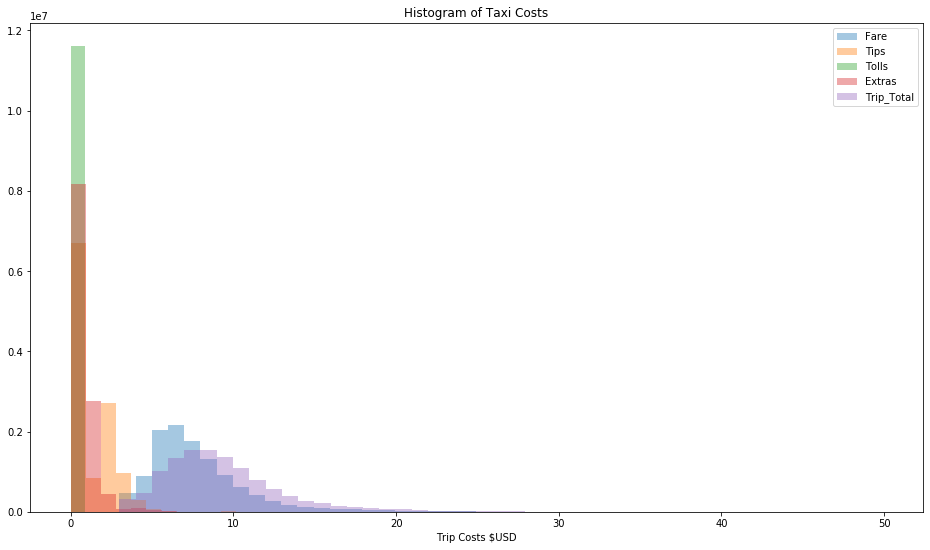

In [8]:
# df3.Trip_Total.hist(bins=100, figsize=(16,9))
fig_dims = (16, 9)
fig, ax = plt.subplots(figsize=fig_dims)
sns.distplot(a=df3['Fare'], label='Fare', ax=ax, kde=False)
sns.distplot(a=df3['Tips'], label='Tips', ax=ax, kde=False)
sns.distplot(a=df3['Tolls'], label='Tolls', ax=ax, kde=False)
sns.distplot(a=df3['Extras'], label='Extras', ax=ax, kde=False)
sns.distplot(a=df3['Trip_Total'], label='Trip_Total', ax=ax, kde=False)

# Force legend to appear
plt.legend()
plt.xlabel('Trip Costs $USD')
plt.title('Histogram of Taxi Costs');

#### Boxplots of Price & Time by Categorical Variables

[(0, 20)]

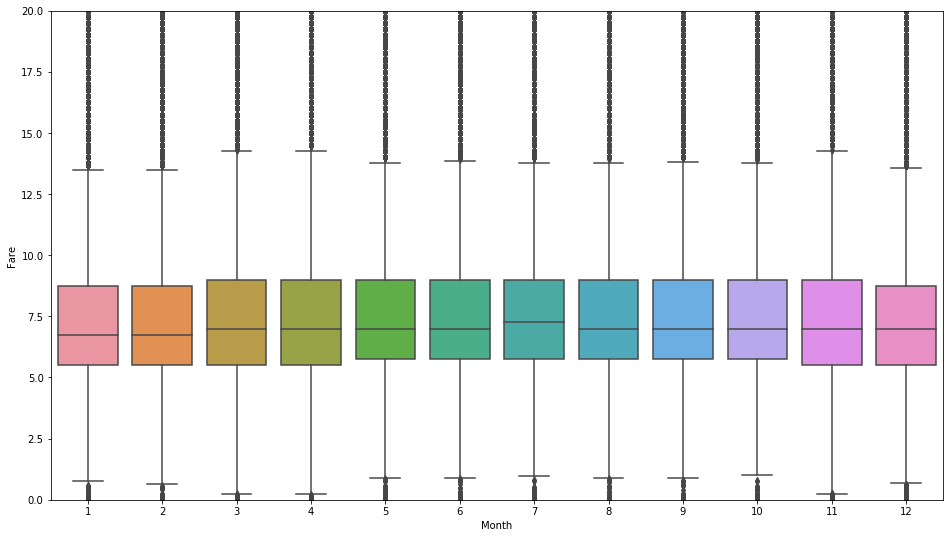

In [9]:
plt.figure(figsize=(16,9))
ax0 = sns.boxplot(data=df3,x='Month',y='Fare')
ax0.set(ylim=(0, 20))

[(0, 1000)]

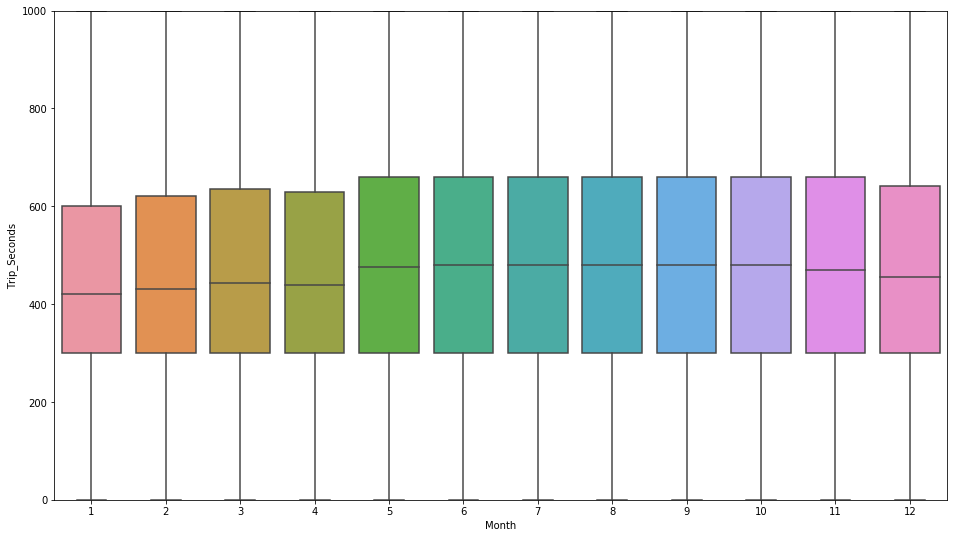

In [10]:
plt.figure(figsize=(16,9))
ax0=sns.boxplot(data=df3,x='Month',y='Trip_Seconds')
ax0.set(ylim=(0, 1000))

[(0, 20)]

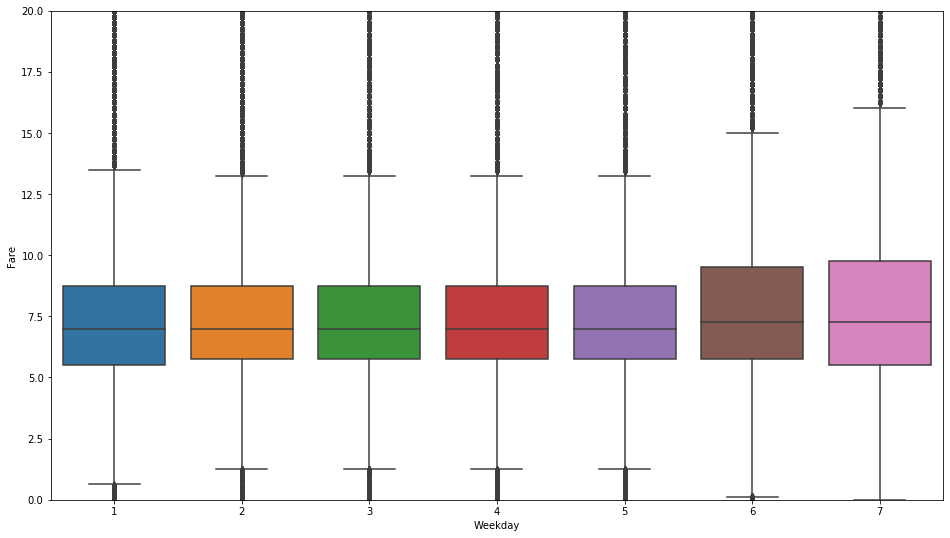

In [11]:
plt.figure(figsize=(16,9))
ax1 = sns.boxplot(data=df3,x='Weekday',y='Fare')
ax1.set(ylim=(0, 20))

[(0, 1000)]

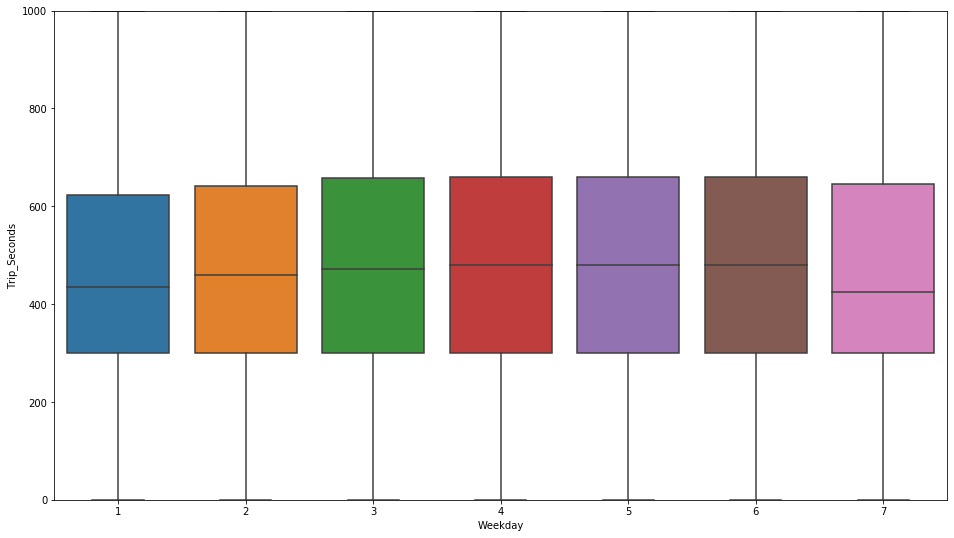

In [12]:
plt.figure(figsize=(16,9))
ax2=sns.boxplot(data=df3,x='Weekday',y='Trip_Seconds')
ax2.set(ylim=(0, 1000))

[(0, 20)]

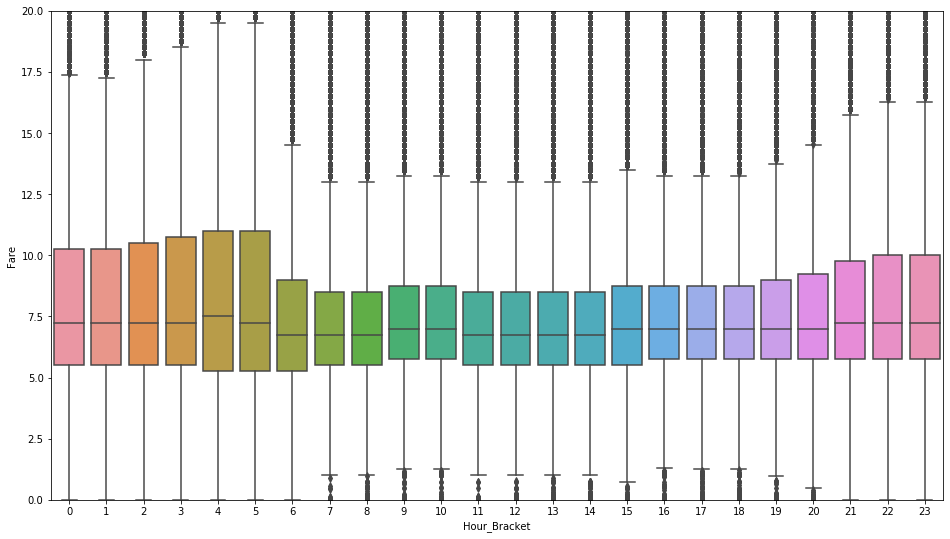

In [13]:
plt.figure(figsize=(16,9))
ax3=sns.boxplot(data=df3,x='Hour_Bracket',y='Fare')
ax3.set(ylim=(0, 20))

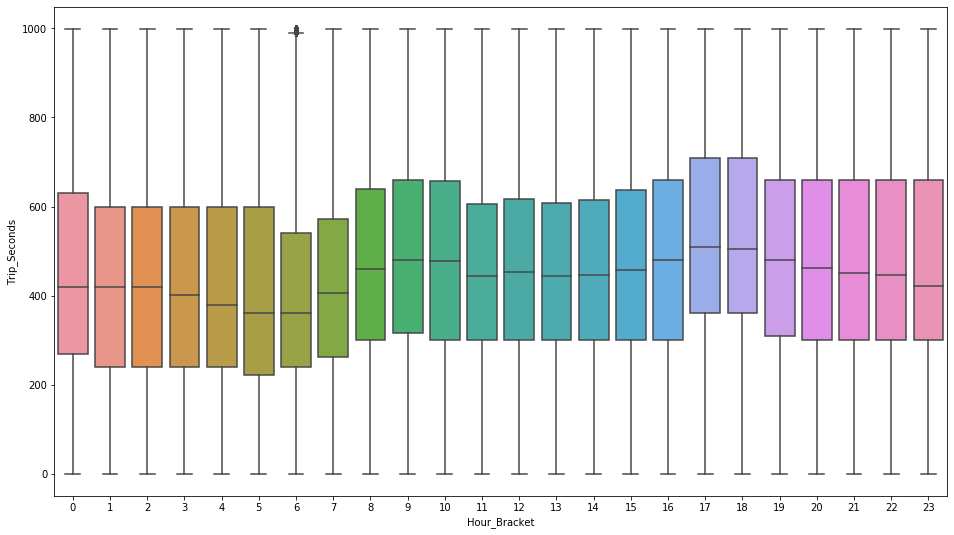

In [14]:
plt.figure(figsize=(16,9))
ax3=sns.boxplot(data=df3,x='Hour_Bracket',y='Trip_Seconds')
# ax3.set(ylim=(0, 1000))

[(0, 40)]

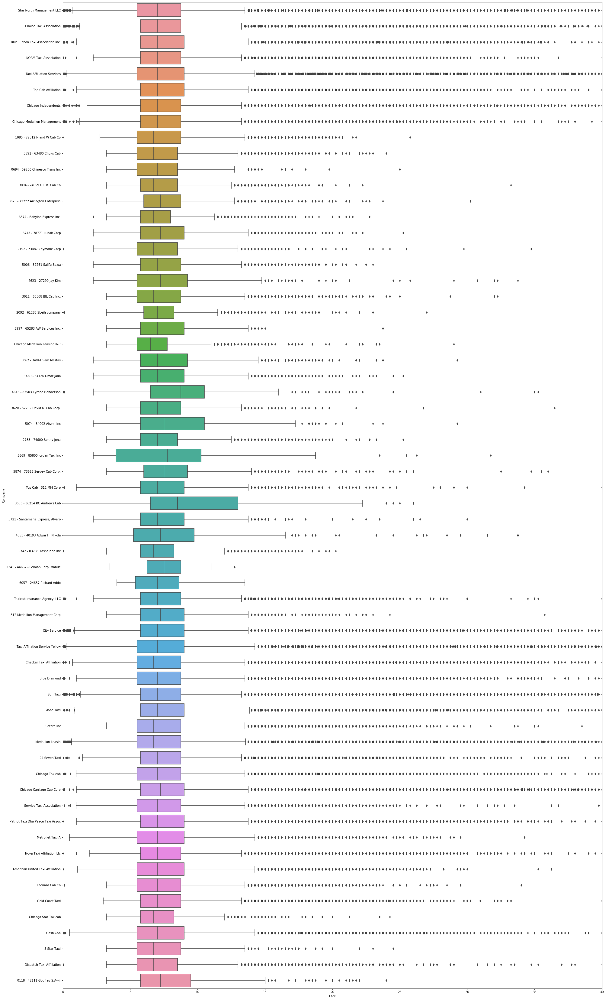

In [15]:
plt.figure(figsize=(32,60))
ax4=sns.boxplot(data=df3,x='Fare',y='Company')
ax4.set(xlim=(0, 40))

[(0, 1000)]

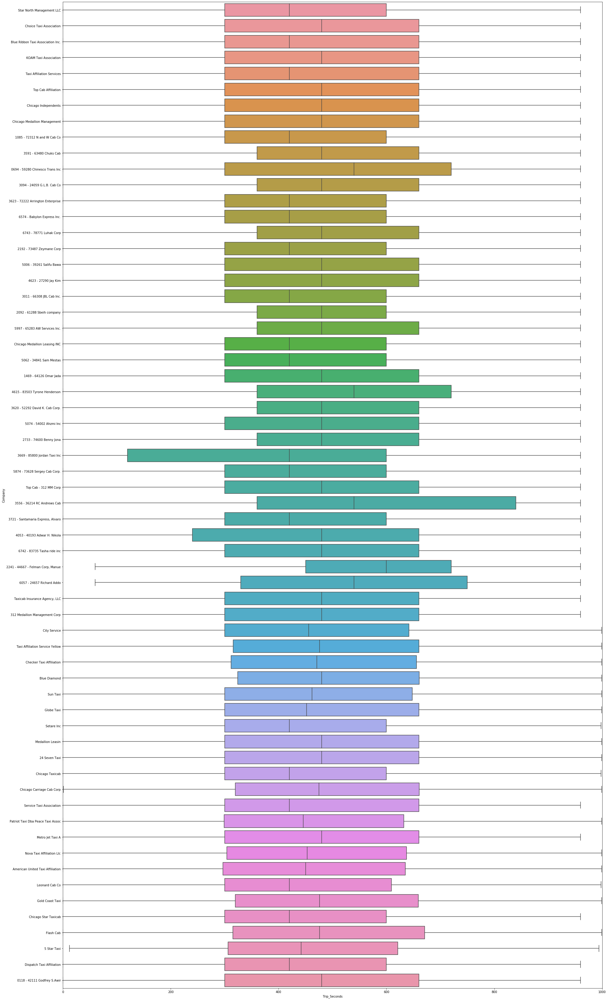

In [16]:
plt.figure(figsize=(32,60))
ax4=sns.boxplot(data=df3,x='Trip_Seconds',y='Company')
ax4.set(xlim=(0, 1000))

[(0, 30)]

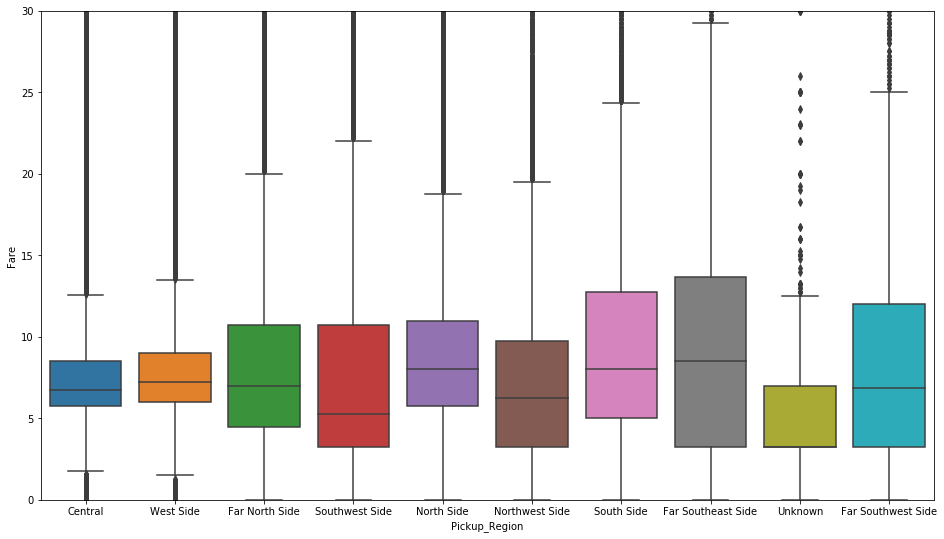

In [17]:
plt.figure(figsize=(16,9))
ax5=sns.boxplot(data=df3,x='Pickup_Region',y='Fare')
ax5.set(ylim=(0, 30))

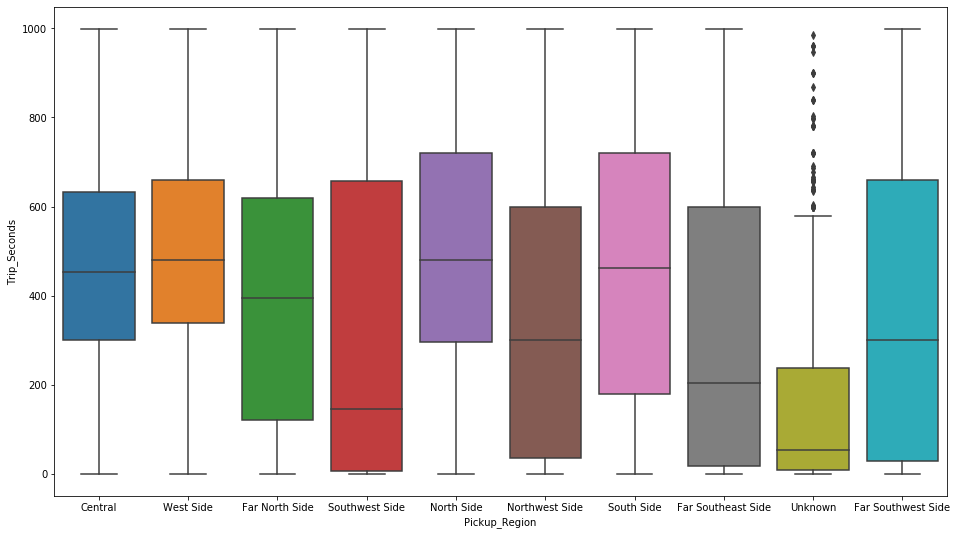

In [18]:
plt.figure(figsize=(16,9))
ax5=sns.boxplot(data=df3,x='Pickup_Region',y='Trip_Seconds')
# ax5.set(ylim=(0, 50))

[(0, 30)]

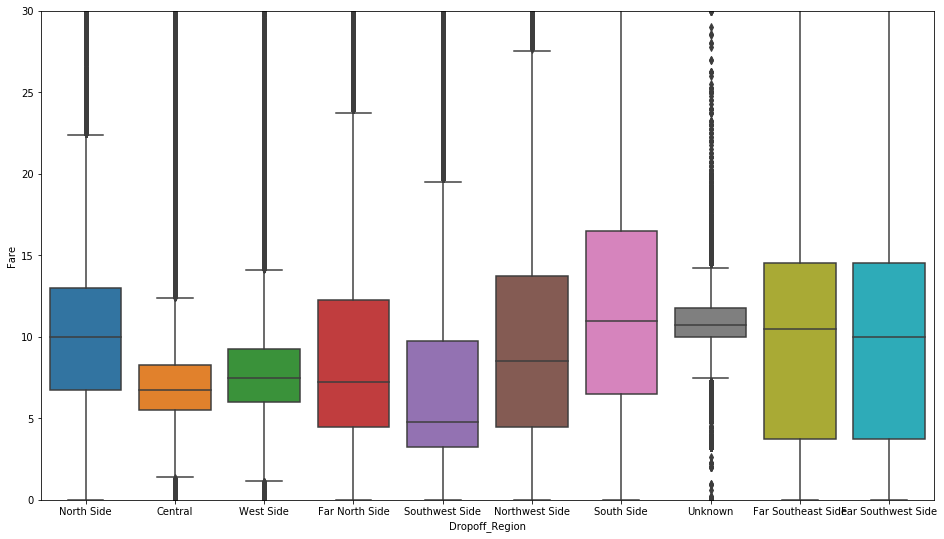

In [19]:
plt.figure(figsize=(16,9))
ax6=sns.boxplot(data=df3,x='Dropoff_Region',y='Fare')
ax6.set(ylim=(0, 30))

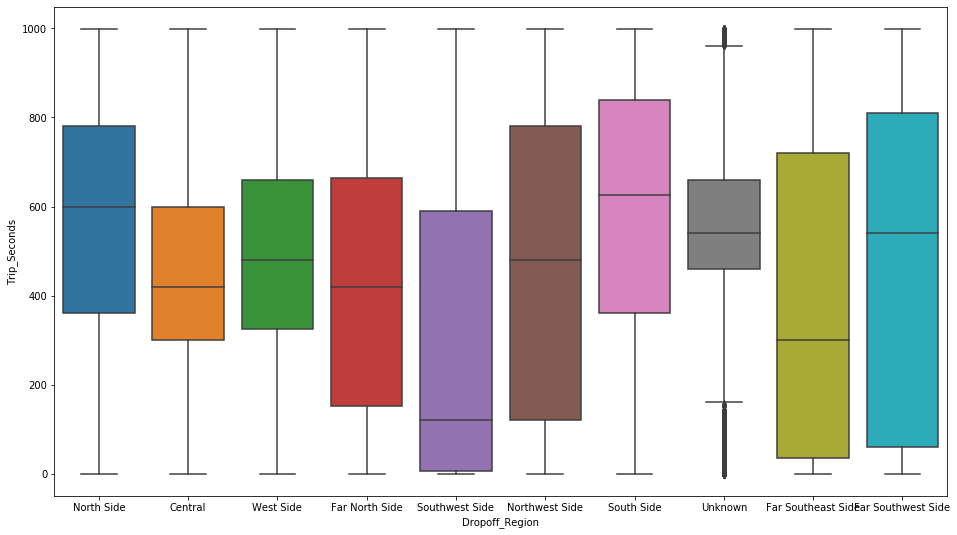

In [20]:
plt.figure(figsize=(16,9))
ax6=sns.boxplot(data=df3,x='Dropoff_Region',y='Trip_Seconds')
# ax6.set(ylim=(0, 50))

[(0, 30)]

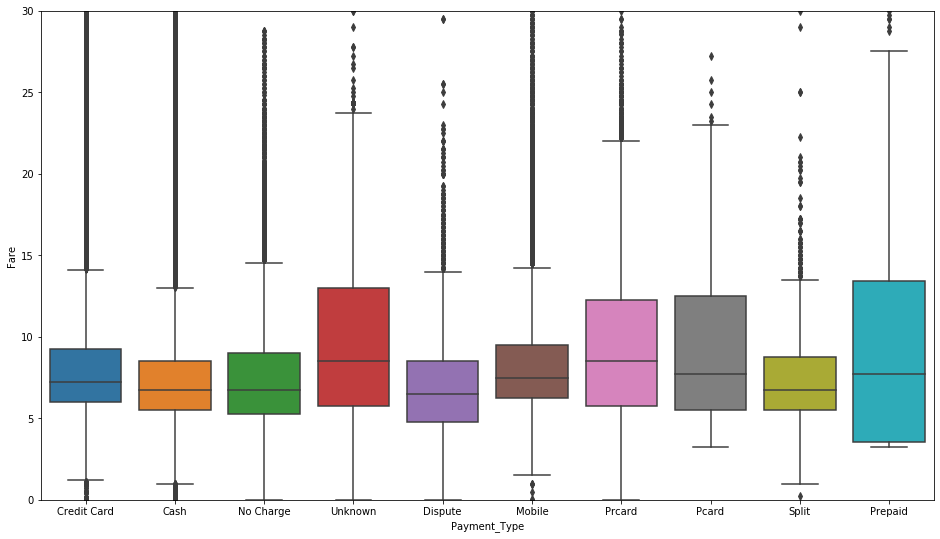

In [21]:
plt.figure(figsize=(16,9))
ax7=sns.boxplot(data=df3,x='Payment_Type',y='Fare')
ax7.set(ylim=(0, 30))

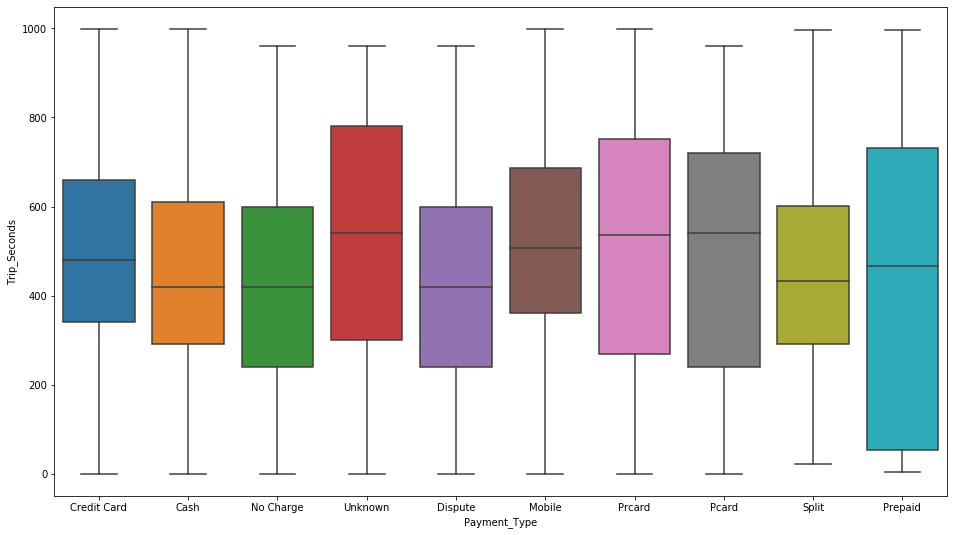

In [22]:
plt.figure(figsize=(16,9))
ax7=sns.boxplot(data=df3,x='Payment_Type',y='Trip_Seconds')
# ax7.set(ylim=(0, 50))

#### Correlation Matrix

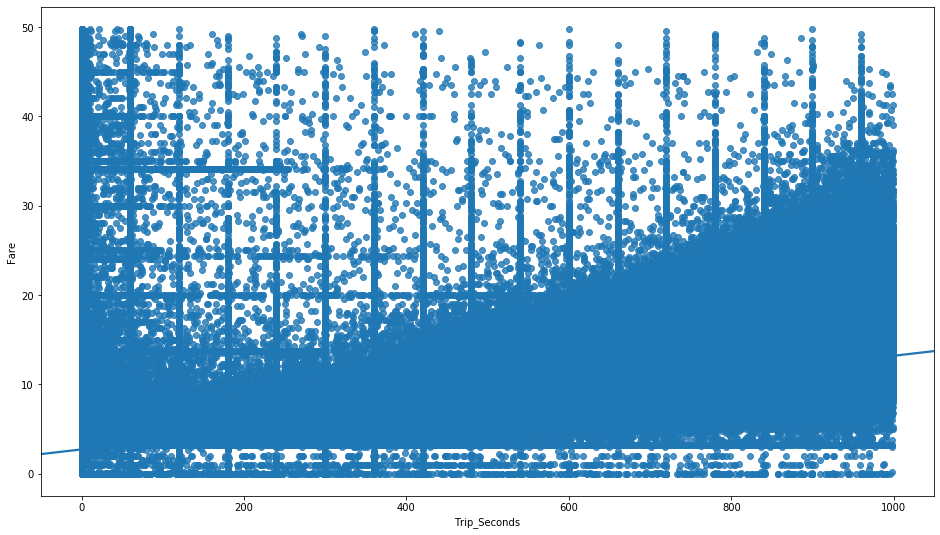

In [23]:
plt.figure(figsize=(16,9))
sns.regplot(x=df3['Trip_Seconds'], y=df3['Fare'])

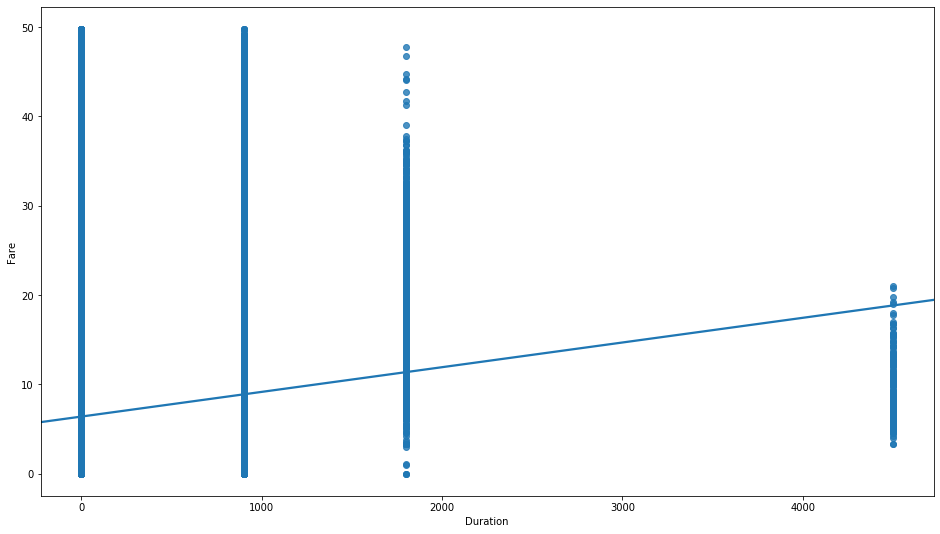

In [24]:
plt.figure(figsize=(16,9))
sns.regplot(x=df3['Duration'], y=df3['Fare'])

In [25]:
df3[['Trip_Miles', 'Trip_Seconds', 'Fare', 'Trip_Total']].corr()

,Trip_Miles,Trip_Seconds,Fare,Trip_Total
Trip_Miles,1.000000,0.381498,0.535487,0.476306
Trip_Seconds,0.381498,1.000000,0.757537,0.642592
Fare,0.535487,0.757537,1.000000,0.863613
Trip_Total,0.476306,0.642592,0.863613,1.000000


#### Heat Map of Price & Time by Weekday & Time Bracket

In [26]:
WeekHour_crosstab = pd.crosstab(df3['Hour_Bracket'], df3['Weekday'], margins = False) 
print(WeekHour_crosstab) 

Weekday            1       2       3       4       5      6      7
Hour_Bracket                                                      
0              23074   22136   27359   30661   41259  73132  85411
1              17769   13893   16863   20096   29201  72289  83331
2              14363    8937   10789   13183   19902  62658  75662
3              11349    6228    7626    9182   13802  46976  59845
4               8828    4572    5225    6092    8483  25773  39474
5               8999    6653    6468    7001    7678   9790  22323
6              22084   22112   21572   21705   20103   8168  12257
7              55184   63209   62648   64295   54807  14535  13704
8              90475  106539  105471  107865   93971  24972  19591
9              94839  109250  108450  110644   98850  37223  29526
10             85468   97347   96966   98803   92552  49933  41511
11             90067  105092  106883  109903  105260  56372  47928
12             98321  112521  115498  119696  120609  62376  5

Text(0.5, 159.0, 'Hour of a Day')

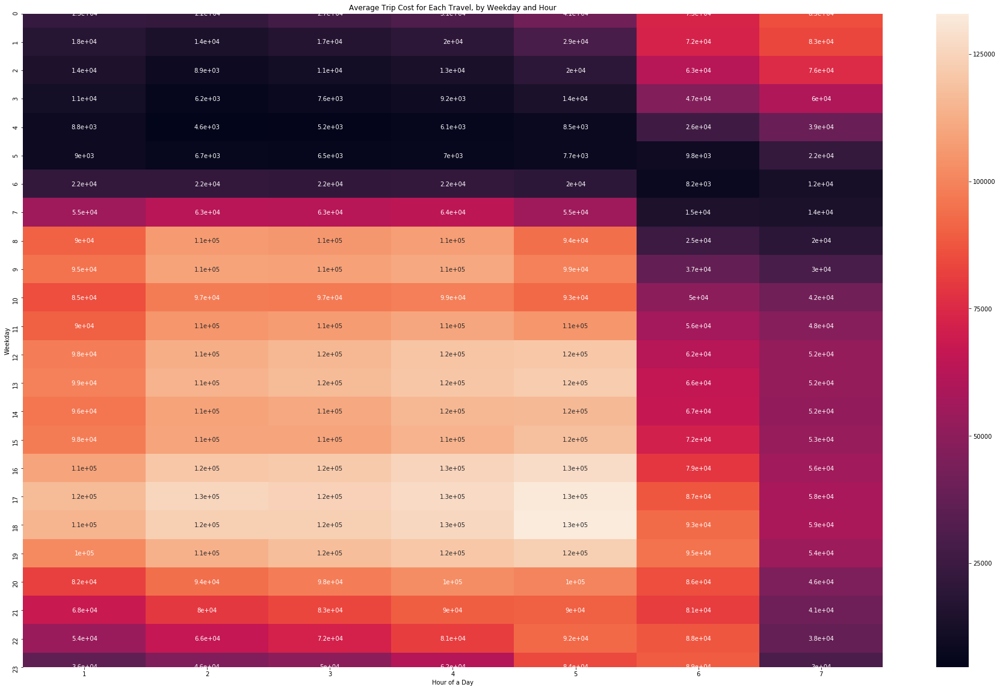

In [27]:
# Set the width and height of the figure
plt.figure(figsize=(32,20))

# Add title
plt.title("Average Trip Cost for Each Travel, by Weekday and Hour")

# Heatmap showing average arrival delay for each airline by month
sns.heatmap(data=WeekHour_crosstab, annot=True)

# Add label for horizontal axis
plt.ylabel("Weekday")

plt.xlabel("Hour of a Day")

In [28]:
MonthHour_crosstab = pd.crosstab(df3['Hour_Bracket'], df3['Month'], margins = False) 
print(MonthHour_crosstab) 

Month            1      2      3      4      5      6      7      8      9   \
Hour_Bracket                                                                  
0             20845  20480  26360  24335  26779  30113  27253  26973  25719   
1             18821  17080  21541  20058  21775  24043  23056  22130  21846   
2             16447  14262  15463  16924  17242  19308  18872  17794  17996   
3             12488  10456  13003  12427  12507  14066  14089  13136  13270   
4              7478   6750   8366   8262   7965   8695   8854   8144   8606   
5              5219   5105   5972   5805   5644   6177   5906   5765   5776   
6              9952  10524  11467  11358  11459  12135   9695  10352   9489   
7             26583  26766  30258  29677  30927  31785  24199  26268  23739   
8             45452  43991  52219  50226  49365  49854  40809  44364  40162   
9             48275  45517  54780  52334  51529  53117  44851  48337  44159   
10            43539  42112  50984  49065  49187  512

Text(0.5, 159.0, 'Hour of a Day')

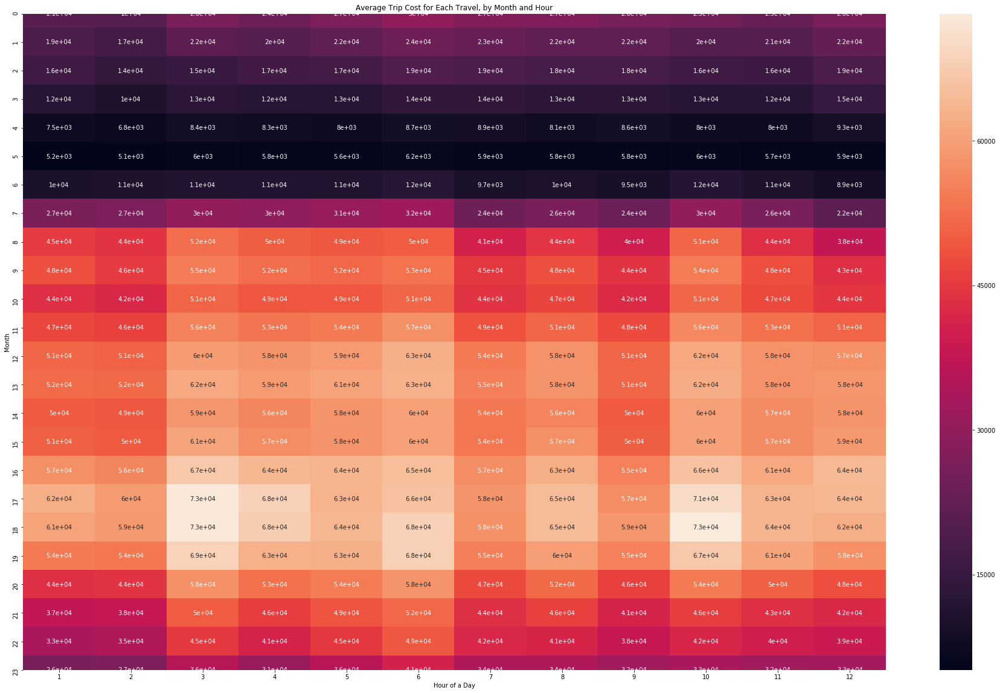

In [29]:
# Set the width and height of the figure
plt.figure(figsize=(32,20))

# Add title
plt.title("Average Trip Cost for Each Travel, by Month and Hour")

# Heatmap showing average arrival delay for each airline by month
sns.heatmap(data=MonthHour_crosstab, annot=True)

# Add label for horizontal axis
plt.ylabel("Month")

plt.xlabel("Hour of a Day")

In [30]:
PickupAreaHour_crosstab = pd.crosstab(df3['Hour_Bracket'], df3['Pickup_Region'], margins = False) 
print(PickupAreaHour_crosstab) 

Pickup_Region  Central  Far North Side  Far Southeast Side  \
Hour_Bracket                                                 
0               194336           17997                  98   
1               158414           15192                  45   
2               125177           12425                  63   
3                93011           10509                  37   
4                56024            9473                  79   
5                35091            9446                 101   
6                70307           11834                 120   
7               199025           15649                 258   
8               351324           17566                 956   
9               393419           21258                 383   
10              399594           22867                 408   
11              465557           23074                 432   
12              524960           22463                 385   
13              545417           22737                 353   
14      

Text(267.0, 0.5, 'Hour of a Day')

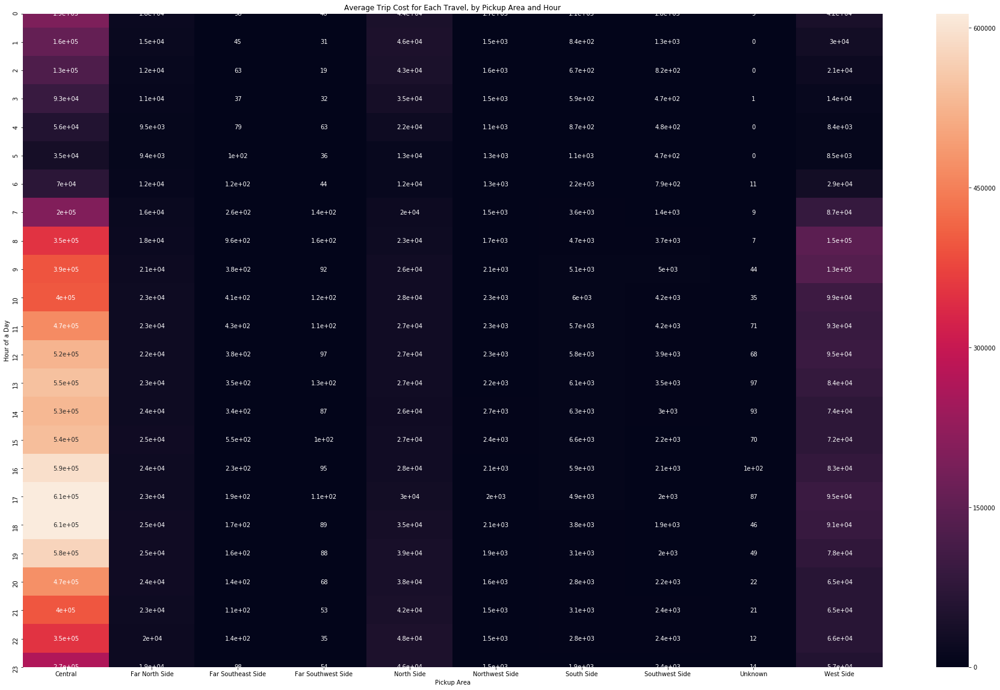

In [31]:
# Set the width and height of the figure
plt.figure(figsize=(32,20))

# Add title
plt.title("Average Trip Cost for Each Travel, by Pickup Area and Hour")

# Heatmap showing average arrival delay for each airline by month
sns.heatmap(data=PickupAreaHour_crosstab, annot=True)

# Add label for horizontal axis
plt.xlabel("Pickup Area")

plt.ylabel("Hour of a Day")

In [32]:
DropoffAreaHour_crosstab = pd.crosstab(df3['Hour_Bracket'], df3['Dropoff_Region'], margins = False) 
print(DropoffAreaHour_crosstab) 

Dropoff_Region  Central  Far North Side  Far Southeast Side  \
Hour_Bracket                                                  
0                161280           22611                 133   
1                126793           20632                  98   
2                 94866           18775                  91   
3                 65595           17062                  64   
4                 38419           14063                  85   
5                 29190           11217                 131   
6                 80211           10436                 134   
7                240919           13571                 267   
8                421313           15922                 988   
9                450049           17986                 470   
10               419101           18982                 457   
11               459071           20121                 445   
12               499329           20675                 439   
13               504570           21566                

Text(267.0, 0.5, 'Hour of a Day')

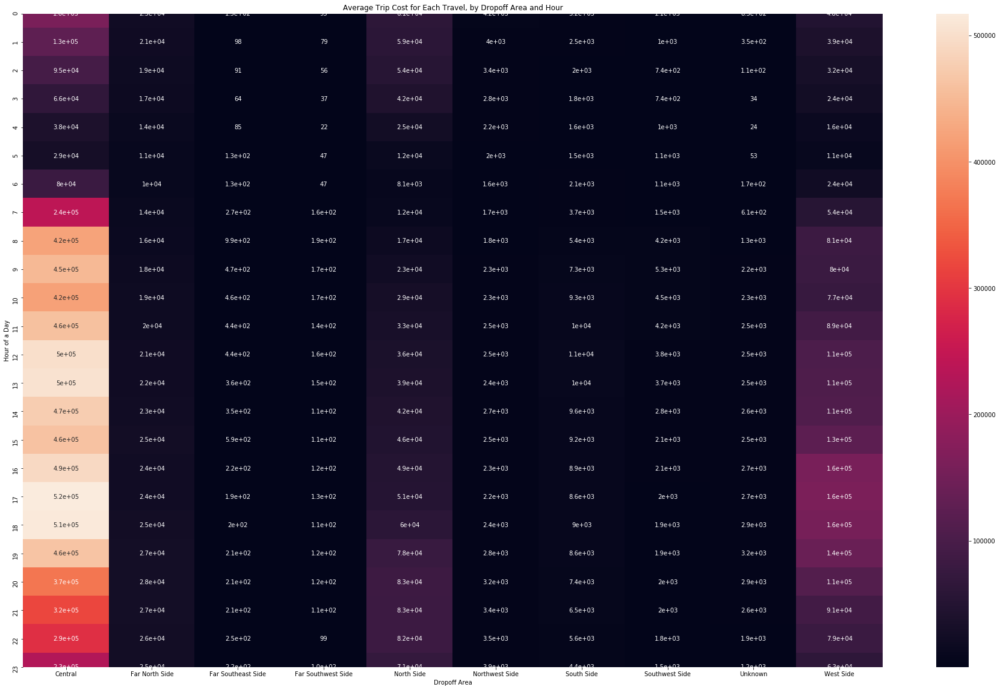

In [33]:
# Set the width and height of the figure
plt.figure(figsize=(32,20))

# Add title
plt.title("Average Trip Cost for Each Travel, by Dropoff Area and Hour")

# Heatmap showing average arrival delay for each airline by month
sns.heatmap(data=DropoffAreaHour_crosstab, annot=True)

# Add label for horizontal axis
plt.xlabel("Dropoff Area")

plt.ylabel("Hour of a Day")

#### Split Data (Stratified)

In [34]:
features = ['Weekday','Hour_Bracket','Month','Pickup_Region','Dropoff_Region','Trip_Miles','Trip_Seconds','Abs_Diff_Longitude','Abs_Diff_Latitude']
# predicts = ['Trip_Total', 'Trip_Seconds']
X = df3[features]
y = df3['Trip_Total']
# y1 = df3['Trip_Total'].values
# y2 = df3['Trip_Seconds'].values

# Split Random Sample to train 2/3 & valid 1/3 
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.4, random_state=8,\
                                     stratify=df3[['Weekday','Hour_Bracket','Month']])

In [35]:
# Object Variables to Transfer
object_cols = [col for col in features if df3[col].dtype == "object"]
object_cols

['Pickup_Region', 'Dropoff_Region']

In [36]:
# Make copy to avoid changing original data 
label_X_train = X_train.copy()
label_X_valid = X_valid.copy()

# Apply label encoder to each column with categorical data
label_encoder = LabelEncoder()
for col in object_cols:
    label_X_train[col] = label_encoder.fit_transform(X_train[col])
    label_X_valid[col] = label_encoder.transform(X_valid[col])

#### Random Forest --- No Character Variable, Character Variable to Numerical, Character Variable One-Hot Encoding

In [37]:
# Unlabeled Variables Onlyn
forest_model = RandomForestRegressor(random_state=8)
forest_model.fit(X_train[X_train.columns.difference(object_cols)], y_train)
pred = forest_model.predict(X_valid[X_valid.columns.difference(object_cols)])
print("MAE",mean_absolute_error(y_valid, pred))
print("RMSE",np.sqrt(mean_squared_error(y_valid, pred)))

C:\Users\danie\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


MAE 1.5249298049215199
RMSE 2.3918303526178564


In [38]:
# With Characteristic Variables to Numerical Variables
forest_model = RandomForestRegressor(random_state=8)
forest_model.fit(label_X_train, y_train)
pred_labeled1 = forest_model.predict(label_X_valid)
print("MAE",mean_absolute_error(y_valid, pred_labeled1))
print("RMSE",np.sqrt(mean_squared_error(y_valid, pred_labeled1)))

C:\Users\danie\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


MAE 1.5118654984690596
RMSE 2.3861676980132205


In [39]:
taxi_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
label2_X_train = pd.DataFrame(taxi_encoder.fit_transform(X_train[object_cols]))
label2_X_valid = pd.DataFrame(taxi_encoder.transform(X_valid[object_cols]))
# Remove categorical columns (will replace with one-hot encoding)
num_X_train = X_train.drop(object_cols, axis=1)
num_X_valid = X_valid.drop(object_cols, axis=1)
num_X_train.index = label2_X_train.index
num_X_valid.index = label2_X_valid.index
label2_X_train2 = pd.concat([num_X_train, label2_X_train], axis=1, ignore_index=True)
label2_X_valid2 = pd.concat([num_X_valid, label2_X_valid], axis=1, ignore_index=True)

In [40]:
# With Characteristic Variables to Numerical Variables one-hot encoding
forest_model = RandomForestRegressor(random_state=8)
forest_model.fit(label2_X_train2, y_train)
pred_labeled2 = forest_model.predict(label2_X_valid2)
print("MAE",mean_absolute_error(y_valid, pred_labeled2))
print("RMSE",np.sqrt(mean_squared_error(y_valid, pred_labeled2)))

C:\Users\danie\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


MAE 1.5101161485009882
RMSE 2.384930313795784


In [41]:
# Without Trip Duration
# With Characteristic Variables to Numerical Variables one-hot encoding
forest_model = RandomForestRegressor(random_state=8)
forest_model.fit(label2_X_train2[label2_X_train2.columns.difference([4])], y_train)
pred_labeled3 = forest_model.predict(label2_X_valid2[label2_X_valid2.columns.difference([4])])
print("MAE",mean_absolute_error(y_valid, pred_labeled3))
print("RMSE",np.sqrt(mean_squared_error(y_valid, pred_labeled3)))
label2_X_train2.columns

C:\Users\danie\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


MAE 1.6186401400231964
RMSE 2.4870500689062185


RangeIndex(start=0, stop=27, step=1)

<Figure size 2304x1440 with 0 Axes>

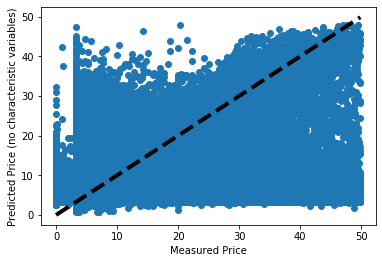

In [42]:
plt.figure(figsize=(32,20))
fig, ax = plt.subplots()
ax.scatter(y_valid, pred)
ax.plot([y_valid.min(), y_valid.max()], [y_valid.min(), y_valid.max()], 'k--', lw=4)
ax.set_xlabel('Measured Price')
ax.set_ylabel('Predicted Price (no characteristic variables)')
plt.show()

<Figure size 2304x1440 with 0 Axes>

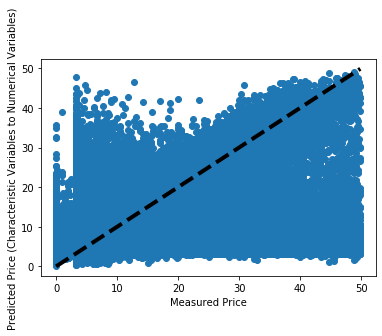

In [43]:
plt.figure(figsize=(32,20))
fig, ax = plt.subplots()
ax.scatter(y_valid, pred_labeled1)
ax.plot([y_valid.min(), y_valid.max()], [y_valid.min(), y_valid.max()], 'k--', lw=4)
ax.set_xlabel('Measured Price')
ax.set_ylabel('Predicted Price (Characteristic Variables to Numerical Variables)')
plt.show()

<Figure size 2304x1440 with 0 Axes>

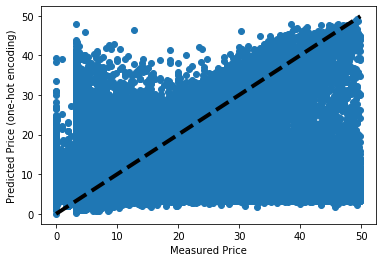

In [44]:
plt.figure(figsize=(32,20))
fig, ax = plt.subplots()
ax.scatter(y_valid, pred_labeled2)
ax.plot([y_valid.min(), y_valid.max()], [y_valid.min(), y_valid.max()], 'k--', lw=4)
ax.set_xlabel('Measured Price')
ax.set_ylabel('Predicted Price (one-hot encoding)')
plt.show()

<Figure size 2304x1440 with 0 Axes>

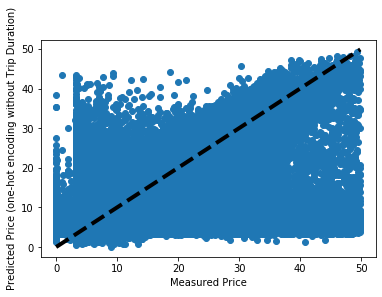

In [45]:
plt.figure(figsize=(32,20))
fig, ax = plt.subplots()
ax.scatter(y_valid, pred_labeled3)
ax.plot([y_valid.min(), y_valid.max()], [y_valid.min(), y_valid.max()], 'k--', lw=4)
ax.set_xlabel('Measured Price')
ax.set_ylabel('Predicted Price (one-hot encoding without Trip Duration)')
plt.show()

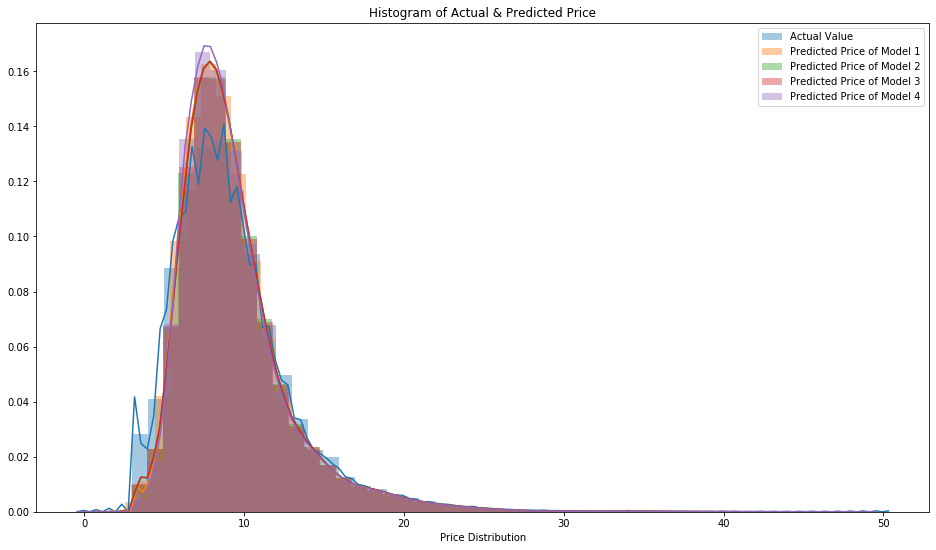

In [46]:
# Actual Price VS Predicted Prices
fig_dims = (16, 9)
fig, ax = plt.subplots(figsize=fig_dims)
sns.distplot(a=y_valid, label='Actual Value', ax=ax)
sns.distplot(a=pred, label='Predicted Price of Model 1', ax=ax)
sns.distplot(a=pred_labeled1, label='Predicted Price of Model 2', ax=ax)
sns.distplot(a=pred_labeled2, label='Predicted Price of Model 3', ax=ax)
sns.distplot(a=pred_labeled3, label='Predicted Price of Model 4', ax=ax)

# Force legend to appear
plt.legend()
plt.xlabel('Price Distribution')
plt.title('Histogram of Actual & Predicted Price');

#### Regression --- No Character Variable, Character Variable to Numerical, Character Variable One-Hot Encoding

In [47]:
# define some handy analysis support function

def plot_prediction_analysis(y, y_pred, figsize=(10,4), title=''):
    fig, axs = plt.subplots(1, 2, figsize=figsize)
    axs[0].scatter(y, y_pred)
    mn = min(np.min(y), np.min(y_pred))
    mx = max(np.max(y), np.max(y_pred))
    axs[0].plot([mn, mx], [mn, mx], c='red')
    axs[0].set_xlabel('$y$')
    axs[0].set_ylabel('$\hat{y}$')
    rmse = np.sqrt(mean_squared_error(y, y_pred))
    evs = explained_variance_score(y, y_pred)
    axs[0].set_title('rmse = {:.2f}, evs = {:.2f}'.format(rmse, evs))
    
    axs[1].hist(y-y_pred, bins=50)
    avg = np.mean(y-y_pred)
    std = np.std(y-y_pred)
    axs[1].set_xlabel('$y - \hat{y}$')
    axs[1].set_title('Histrogram prediction error, $\mu$ = {:.2f}, $\sigma$ = {:.2f}'.format(avg, std))
    
    if title!='':
        fig.suptitle(title)

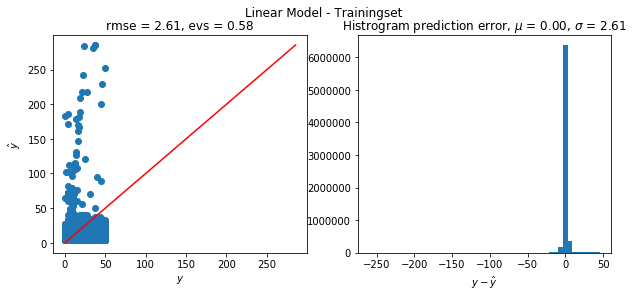

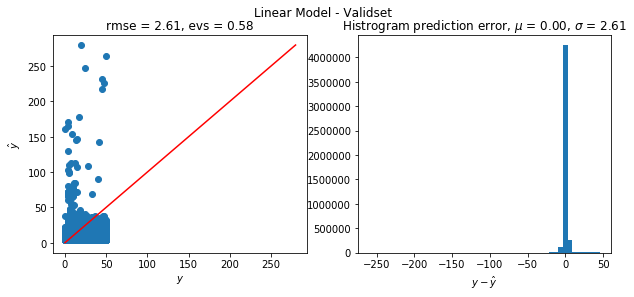

In [48]:
model_lin = Pipeline((
        ("standard_scaler", StandardScaler()),
        ("lin_reg", LinearRegression()),
    ))
model_lin.fit(label2_X_train2, y_train)

y_train_pred = model_lin.predict(label2_X_train2)
plot_prediction_analysis(y_train, y_train_pred, title='Linear Model - Trainingset')

y_valid_pred = model_lin.predict(label2_X_valid2)
plot_prediction_analysis(y_valid, y_valid_pred, title='Linear Model - Validset')

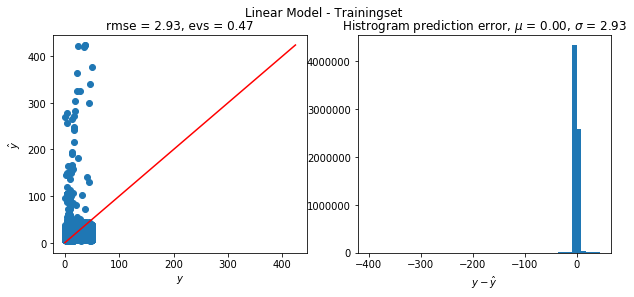

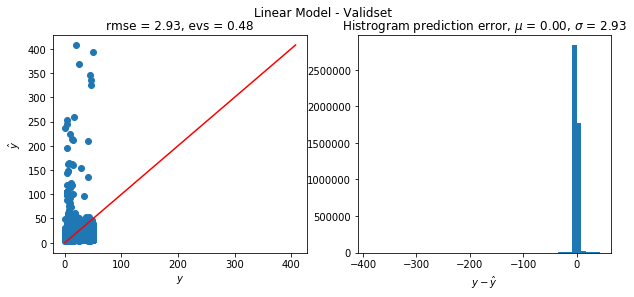

In [49]:
# Without Time Variable
model_lin = Pipeline((
        ("standard_scaler", StandardScaler()),
        ("lin_reg", LinearRegression()),
    ))
model_lin.fit(label2_X_train2[label2_X_train2.columns.difference([4])], y_train)

y_train_pred = model_lin.predict(label2_X_train2[label2_X_train2.columns.difference([4])])
plot_prediction_analysis(y_train, y_train_pred, title='Linear Model - Trainingset')

y_valid_pred = model_lin.predict(label2_X_valid2[label2_X_valid2.columns.difference([4])])
plot_prediction_analysis(y_valid, y_valid_pred, title='Linear Model - Validset')

#### Test Set 2019 Data

In [82]:
test, meta2 = pyreadstat.read_sas7bdat('taxitrip19.sas7bdat')
test['Weekday'] = test['Trip_Start_Timestamp'].apply(lambda x : x.isoweekday())
test['Month'] = test['Trip_Start_Timestamp'].apply(lambda x : x.month)
test['Hour_Bracket'] = test['Trip_Start_Timestamp'].apply(lambda x : x.hour)
test['Duration'] = (test['Trip_End_Timestamp'] - test['Trip_Start_Timestamp'])
test['Duration'] = test['Duration'].apply(lambda x : x.seconds)

MapRegion = {"Central": [8, 32, 33],\
             "North Side": [5, 6, 7, 21, 22],\
             "Far North Side": [1,2,3,4,9,10,11,12,13,14,76,77],\
             "Northwest Side": [i for i in range(15,21)],\
             "West Side": [i for i in range(23,32)],\
             "South Side": [34,35,36,37,38,39,40,41,42,43,60,69],\
             "Southwest Side": [i for i in list(range(56,60)) + list(range(61,70))],\
             "Far Southeast Side": [i for i in range(44,56)],\
             "Far Southwest Side": [i for i in range(70,76)],\
             "Unknown": [0]
        }

test['Pickup_Community_Area'] = np.nan_to_num(test['Pickup_Community_Area']).astype(int)
test['Dropoff_Community_Area'] = np.nan_to_num(test['Dropoff_Community_Area']).astype(int)

test['Pickup_Region'] = test['Pickup_Community_Area'].apply(lambda x: [k for k, v in MapRegion.items() if x in v][0])
test['Dropoff_Region'] = test['Dropoff_Community_Area'].apply(lambda x: [k for k, v in MapRegion.items() if x in v][0])
test['Abs_Diff_Longitude'] = (test.Dropoff_Centroid_Longitude - test.Pickup_Centroid_Longitude).abs()
test['Abs_Diff_Latitude'] = (test.Dropoff_Centroid_Latitude - test.Pickup_Centroid_Latitude).abs()
(test['Trip_End_Timestamp'] - test['Trip_Start_Timestamp']).apply(lambda x : x.seconds)
test = test.dropna()
test = test[test.Trip_Total<50]
test = test[test.Trip_Seconds<1000]
X_test = test[features]
y_test = test['Trip_Total']

#### Random Forest

In [83]:
taxi_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
label2_X_train = pd.DataFrame(taxi_encoder.fit_transform(X_train[object_cols]))
label2_X_test = pd.DataFrame(taxi_encoder.transform(X_test[object_cols]))
# Remove categorical columns (will replace with one-hot encoding)
num_X_train = X_train.drop(object_cols, axis=1)
num_X_test = X_test.drop(object_cols, axis=1)
num_X_train.index = label2_X_train.index
num_X_test.index = label2_X_test.index
label2_X_train2 = pd.concat([num_X_train, label2_X_train], axis=1, ignore_index=True)
label2_X_test2 = pd.concat([num_X_test, label2_X_test], axis=1, ignore_index=True)


# Without Trip Duration
# With Characteristic Variables to Numerical Variables one-hot encoding on the Test Set of 2019 data
forest_model = RandomForestRegressor(random_state=8)
forest_model.fit(label2_X_train2[label2_X_train2.columns.difference([4])], y_train)
pred_labeled4 = forest_model.predict(label2_X_test2[label2_X_test2.columns.difference([4])])
print("MAE",mean_absolute_error(y_test, pred_labeled4))
print("RMSE",np.sqrt(mean_squared_error(y_test, pred_labeled4)))

C:\Users\danie\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


MAE 1.6619135021990157
RMSE 2.6484094929053876


#### Linear Regression

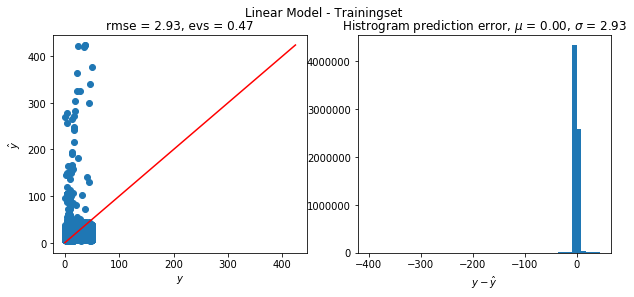

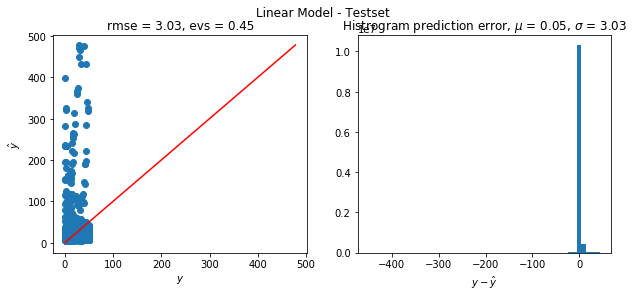

In [84]:
# Without Time Variable
model_lin = Pipeline((
        ("standard_scaler", StandardScaler()),
        ("lin_reg", LinearRegression()),
    ))
model_lin.fit(label2_X_train2[label2_X_train2.columns.difference([4])], y_train)

y_train_pred2 = model_lin.predict(label2_X_train2[label2_X_train2.columns.difference([4])])
plot_prediction_analysis(y_train, y_train_pred, title='Linear Model - Trainingset')

y_test_pred2 = model_lin.predict(label2_X_test2[label2_X_test2.columns.difference([4])])
plot_prediction_analysis(y_test, y_test_pred2, title='Linear Model - Testset')

#### Geo-Features

In [65]:
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

In [66]:
# Create a map of Chicago
m_1 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Display the map
m_1

In [67]:
# Select one day
tomap = y_valid - pred_labeled3
tomap.head()

2750709     6.918478
1074969    -0.178509
1433106    -1.595833
2683835    -0.980000
13715892    3.275000
Name: Trip_Total, dtype: float64

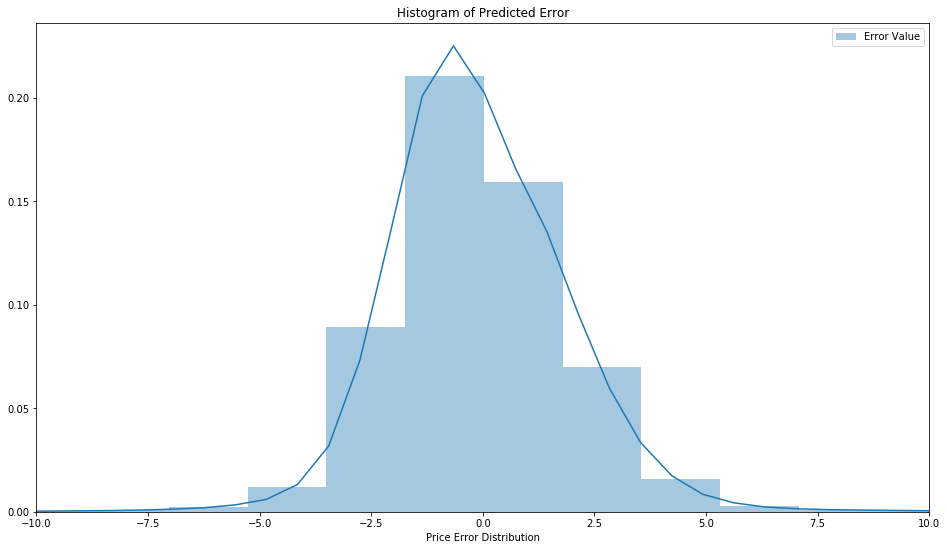

In [68]:
# Actual Price VS Predicted Prices
fig_dims = (16, 9)
fig, ax = plt.subplots(figsize=fig_dims)
sns.distplot(a=tomap, label='Error Value', ax=ax)
ax.set(xlim=(-10, 10))
# Force legend to appear
plt.legend()
plt.xlabel('Price Error Distribution')
plt.title('Histogram of Predicted Error');

In [69]:
acurate = tomap.index[abs(tomap.values) <= 2.5].tolist()
inacurate = tomap.index[abs(tomap.values) >= 2.5].tolist()
len(acurate)

3808737

In [70]:
# Monday Morning Accurate Origin
acuratepred = df3.ix[acurate]
m_2 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=acuratepred[(acuratepred.Weekday == 1) & (acuratepred.Hour_Bracket < 10) & (acuratepred.Hour_Bracket >= 6)][['Pickup_Centroid_Latitude', 'Pickup_Centroid_Longitude']], radius=10).add_to(m_2)

# Display the map
m_2

C:\Users\danie\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  


In [71]:
# Monday Morning Inaccurate Origin
inacuratepred = df3.ix[inacurate]
m_3 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=inacuratepred[(inacuratepred.Weekday == 1) & (inacuratepred.Hour_Bracket < 10) & (inacuratepred.Hour_Bracket >= 6)][['Pickup_Centroid_Latitude', 'Pickup_Centroid_Longitude']], radius=10).add_to(m_3)

# Display the map
m_3

C:\Users\danie\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  


In [72]:
# Monday Morning Accurate Target
m_4 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=acuratepred[(acuratepred.Weekday == 1) & (acuratepred.Hour_Bracket < 10) & (acuratepred.Hour_Bracket >= 6)][['Dropoff_Centroid_Latitude', 'Dropoff_Centroid_Longitude']], radius=10).add_to(m_4)

# Display the map
m_4

In [73]:
# Monday Morning Inaccurate Target
m_5 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=inacuratepred[(inacuratepred.Weekday == 1) & (inacuratepred.Hour_Bracket < 10) & (inacuratepred.Hour_Bracket >= 6)][['Dropoff_Centroid_Latitude', 'Dropoff_Centroid_Longitude']], radius=10).add_to(m_5)

# Display the map
m_5

In [74]:
# Saturday Night Accurate Origin
acuratepred = df3.ix[acurate]
m_6 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=acuratepred[(acuratepred.Weekday == 6) & (acuratepred.Hour_Bracket < 23) & (acuratepred.Hour_Bracket >= 18)][['Pickup_Centroid_Latitude', 'Pickup_Centroid_Longitude']], radius=10).add_to(m_6)

# Display the map
m_6

C:\Users\danie\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  


In [75]:
# Saturday Night Inaccurate Origin
inacuratepred = df3.ix[inacurate]
m_7 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=inacuratepred[(inacuratepred.Weekday == 6) & (inacuratepred.Hour_Bracket < 23) & (inacuratepred.Hour_Bracket >= 18)][['Pickup_Centroid_Latitude', 'Pickup_Centroid_Longitude']], radius=10).add_to(m_7)

# Display the map
m_7

C:\Users\danie\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  


In [76]:
# Saturday Night Accurate Target
acuratepred = df3.ix[acurate]
m_8 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=acuratepred[(acuratepred.Weekday == 6) & (acuratepred.Hour_Bracket < 23) & (acuratepred.Hour_Bracket >= 18)][['Dropoff_Centroid_Latitude', 'Dropoff_Centroid_Longitude']], radius=10).add_to(m_8)

# Display the map
m_8

C:\Users\danie\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  


In [77]:
# Saturday Night Inaccurate Target
inacuratepred = df3.ix[inacurate]
m_9 = folium.Map(location=[41.881832, -87.623177], tiles='openstreetmap', zoom_start=10)

# Create the map
HeatMap(data=inacuratepred[(inacuratepred.Weekday == 6) & (inacuratepred.Hour_Bracket < 23) & (inacuratepred.Hour_Bracket >= 18)][['Dropoff_Centroid_Latitude', 'Dropoff_Centroid_Longitude']], radius=10).add_to(m_9)

# Display the map
m_9

C:\Users\danie\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated
  
